In [ ]:
# Imports
import re
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from gensim.models import Word2Vec
from tqdm import tqdm

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score, f1_score, mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import SVR

import torch
from torch import nn
from torch.optim import AdamW
from torch.utils.data import DataLoader, Dataset, TensorDataset

from transformers import (
    AdamW,
    BertConfig,
    BertForSequenceClassification,
    BertModel,
    BertTokenizer,
    Trainer,
    TrainingArguments,
    pipeline,
)



In [ ]:
# Dataset
df = pd.read_json('full_format_recipes.json')

# Features
X = df.drop(df[["rating"]], axis=1)

# Targets
Y = df[['rating']]

print(X.info())
print(Y.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20130 entries, 0 to 20129
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype              
---  ------       --------------  -----              
 0   directions   20111 non-null  object             
 1   fat          15908 non-null  float64            
 2   date         20111 non-null  datetime64[ns, UTC]
 3   categories   20111 non-null  object             
 4   calories     15976 non-null  float64            
 5   desc         13495 non-null  object             
 6   protein      15929 non-null  float64            
 7   title        20111 non-null  object             
 8   ingredients  20111 non-null  object             
 9   sodium       15974 non-null  float64            
dtypes: datetime64[ns, UTC](1), float64(4), object(5)
memory usage: 1.5+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20130 entries, 0 to 20129
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  ----

directions                  object
fat                        float64
date           datetime64[ns, UTC]
categories                  object
calories                   float64
desc                        object
protein                    float64
rating                     float64
title                       object
ingredients                 object
sodium                     float64
dtype: object


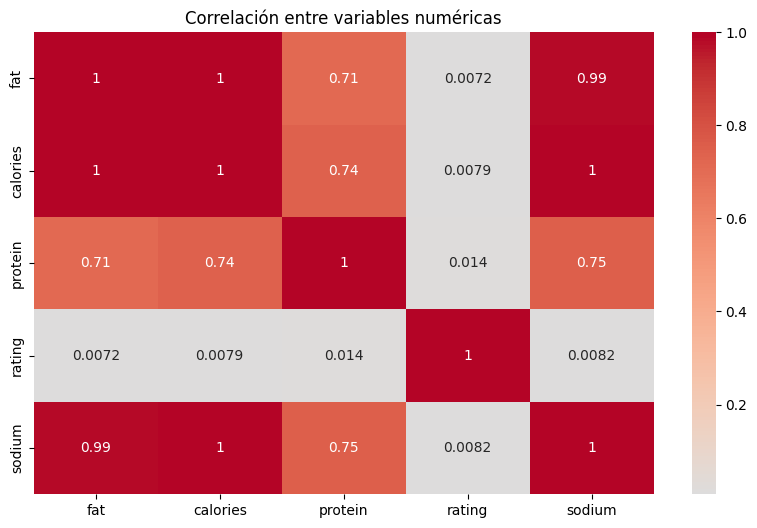

In [ ]:
# Variable analyisis (float)
print(df.dtypes)
df_numerico = df.select_dtypes(include=['float64', 'int64'])

# Numeric variables correlation
plt.figure(figsize=(10, 6))
sns.heatmap(df_numerico.corr(), annot=True, cmap="coolwarm", center=0)
plt.title("Correlación entre variables numéricas")
plt.show()

There is no linear correlation between the input variables and the target variable.
As there is no linear correlation, a scatter plot can be done to see non-linear correlation.

       rating
0       2.500
1       4.375
2       3.750
3       5.000
4       3.125
...       ...
20125   3.125
20126   4.375
20127   4.375
20128   4.375
20129   4.375

[20130 rows x 1 columns]
       calories
0         426.0
1         403.0
2         165.0
3           NaN
4         547.0
...         ...
20125      28.0
20126     671.0
20127     563.0
20128     631.0
20129     560.0

[20130 rows x 1 columns]


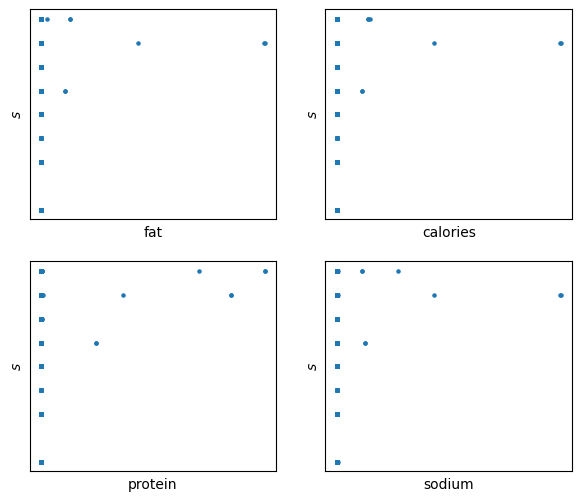

In [ ]:
# Numeric imput vs target data graph
variables = ['fat', 'calories', 'protein', 'sodium']

fig, axs = plt.subplots(2, 2, figsize=(7, 6))
nrows = 2
ncols = 2
print(Y)
print(df[["calories"]])

for i, var in enumerate(variables):
    ax = plt.subplot(nrows, ncols, i+1)
    ax.scatter(df[var], Y, s=5)
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    plt.xlabel(f'{var}')
    plt.ylabel('$s$')


The graphical representation shows that most of the points are clustered around low values of the variables. However, the scale used may not be the most suitable, as there are outliers that cause the points to overlap. To achieve a clearer visualization of these data, the graph will be represented using a logarithmic scale.

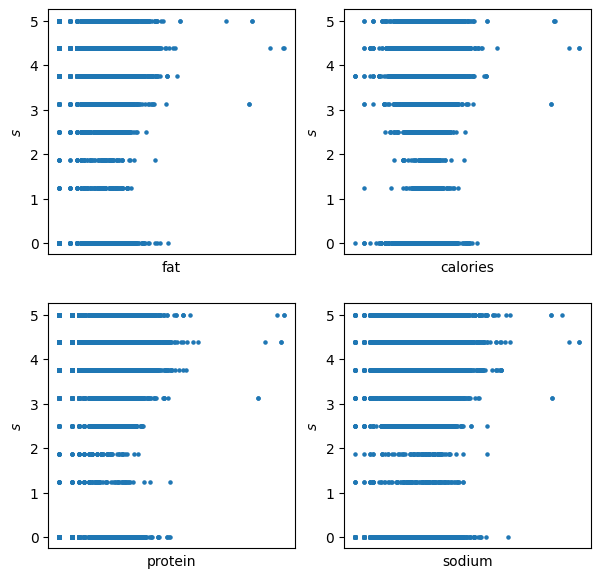

In [ ]:
# # Numeric imput vs target data graph (log)
variables = ['fat', 'calories', 'protein', 'sodium']

fig, axs = plt.subplots(2, 2, figsize=(7, 7))
nrows = 2
ncols = 2
for i, var in enumerate(variables):
    ax = plt.subplot(nrows, ncols, i+1)
    ax.set_xscale('log')
    ax.scatter(df[var], Y, s=5)

    ax.get_xaxis().set_ticks([])
    # ax.get_yaxis().set_ticks([])

    plt.xlabel(f'{var}')
    plt.ylabel('$s$')

As the graphics shows, with the logaritmic scale, the points are not as overlap as they were before. However, it is difficult to observe a trend in these graphics as the poins distribution is similar for each value of the rating.

Another thing that can be done is calculate the mean of the variables for each vaule of s

In [ ]:
# Mean and median values of the numeric data
valores_unicos = Y['rating'].dropna().unique()
valores_unicos = sorted(valores_unicos)
indices = {}
mean = {}
for i,v in enumerate(valores_unicos):
    indices[i] = Y[Y['rating'] == v].index.tolist()

medias_por_valor = {}
medianas_por_valor = {}
for v, idx_list in indices.items():
    medias = {}
    medianas = {}
    for var in variables:
        medias[var] = X.loc[idx_list, var].mean()
        medianas[var] = X.loc[idx_list, var].median()
    medias_por_valor[valores_unicos[v]] = medias
    medianas_por_valor[valores_unicos[v]] = medianas

df_medias = pd.DataFrame(medias_por_valor).T
df_medianas = pd.DataFrame(medianas_por_valor).T

print(df_medias)
print(" ")
print(df_medianas)

              fat      calories     protein        sodium
0.000   17.527927    354.799553   11.063685    559.773472
1.250   19.390244    379.174603   14.629032    410.666667
1.875   23.580247    369.950617   10.259259    647.037037
2.500   20.880196    382.553398   13.919315    493.844660
3.125  345.786266   6200.974271  118.433962   6420.680961
3.750   29.048804    508.210171   22.211492    736.065590
4.375  669.674996  11689.475415   99.157045  10953.468260
5.000  260.964049   6559.749058  325.110113   7376.168550
 
        fat  calories  protein  sodium
0.000   7.0     207.0      3.0    80.0
1.250  13.0     269.5      5.0   123.0
1.875  14.0     271.0      6.0   204.0
2.500  14.0     273.0      6.0   205.5
3.125  16.0     314.5      8.0   264.0
3.750  18.0     346.0      9.0   313.0
4.375  20.0     381.0     10.0   347.0
5.000  17.0     301.0      6.0   243.0


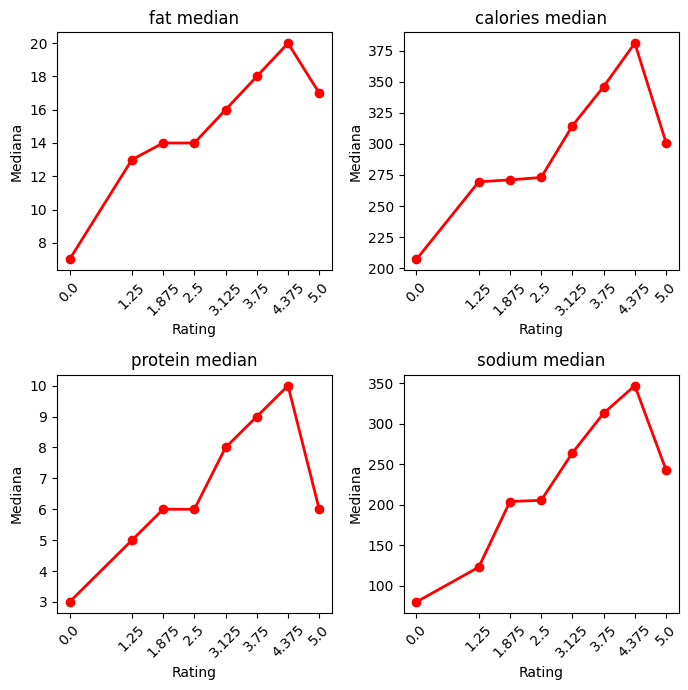

In [ ]:
# Mean and median values of the numeric data (plot)
variables = ['fat', 'calories', 'protein', 'sodium']
medianas_por_rating = df.groupby('rating')[variables].median()

fig, axes = plt.subplots(2, 2, figsize=(7, 7))

for i, var in enumerate(variables):
    ax = axes[i // 2, i % 2]  # Ubicar los gráficos en la cuadrícula 2x2
    medianas_por_rating[var].plot(kind='line', ax=ax, marker='o', color='red', linewidth=2)
    ax.set_title(f'{var} median')
    ax.set_xlabel('Rating')
    ax.set_ylabel('Mediana')
    ax.set_xticks(medianas_por_rating.index)
    ax.set_xticklabels(medianas_por_rating.index, rotation=45)

plt.tight_layout()
plt.show()

General pattern: As the rating increases, the variables fat, calories, protein, and sodium tend to rise as well, suggesting that products with higher ratings generally contain more fat, calories, protein, and sodium. This could indicate that higher-rated products have a greater amount of nutrients or ingredients, though they may also be more caloric and contain more sodium and fat.

Nevertheless, the highest ratings tend to decrease towards average values compared to previous ratings.

CATEGORIES VARIABLE

In [ ]:
# Dataset
df = pd.read_json('full_format_recipes.json')

# Features
X = df.drop(df[["rating"]], axis=1)

# targets
Y = df[['rating']]

print(df['categories'])

0        [Sandwich, Bean, Fruit, Tomato, turkey, Vegeta...
1        [Food Processor, Onion, Pork, Bake, Bastille D...
2        [Soup/Stew, Dairy, Potato, Vegetable, Fennel, ...
3        [Fish, Olive, Tomato, Sauté, Low Fat, Low Cal,...
4        [Cheese, Dairy, Pasta, Vegetable, Side, Bake, ...
                               ...                        
20125    [Mixer, Cheese, Egg, Fry, Cocktail Party, Parm...
20126    [Side, Kid-Friendly, High Fiber, Dinner, Parme...
20127    [Onion, Poultry, turkey, Vegetable, Bake, Kid-...
20128    [Milk/Cream, Citrus, Dairy, Fish, Garlic, Past...
20129    [Pork, Bake, Roast, Christmas, Ham, Winter, Bo...
Name: categories, Length: 20130, dtype: object


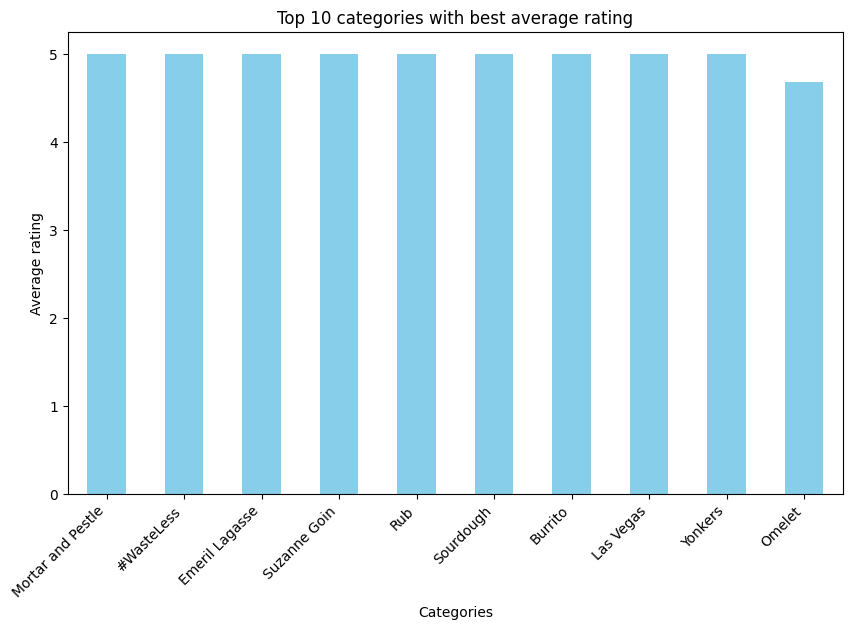

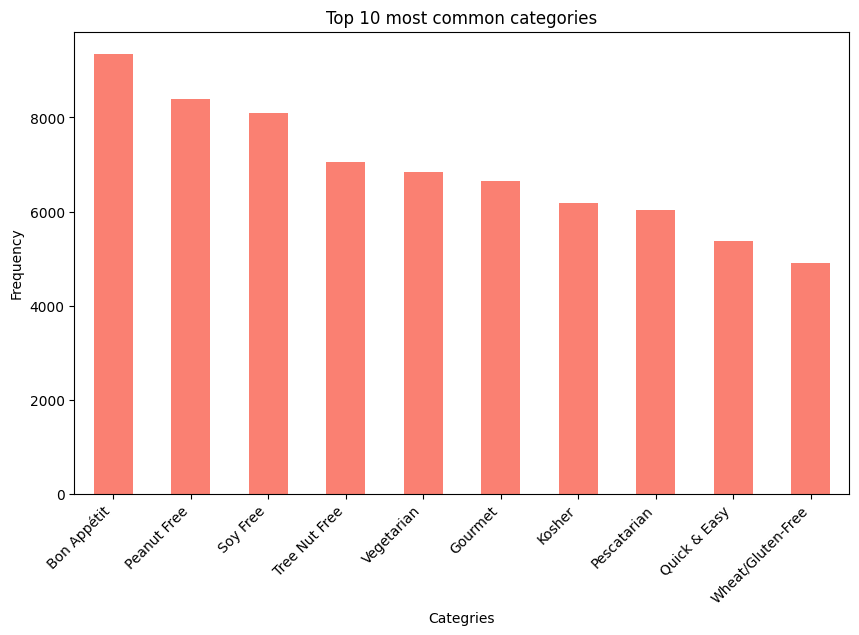

In [ ]:
# Categories exploding
df_exploded = df.explode('categories')

# Group by categories and calculate the average rating
category_rating = df_exploded.groupby('categories')['rating'].mean().sort_values(ascending=False)

# 10 categories plot with the best average rating
plt.figure(figsize=(10,6))
category_rating.head(10).plot(kind='bar', color='skyblue')
plt.title('Top 10 categories with best average rating')
plt.xlabel('Categories')
plt.ylabel('Average rating')
plt.xticks(rotation=45, ha='right')
plt.show()

# Frequency of the most common categories
category_counts = df_exploded['categories'].value_counts()

# Plot of the frequency
plt.figure(figsize=(10,6))
category_counts.head(10).plot(kind='bar', color='salmon')
plt.title('Top 10 most common categories')
plt.xlabel('Categries')
plt.ylabel('Frequency')
plt.xticks(rotation=45, ha='right')
plt.show()

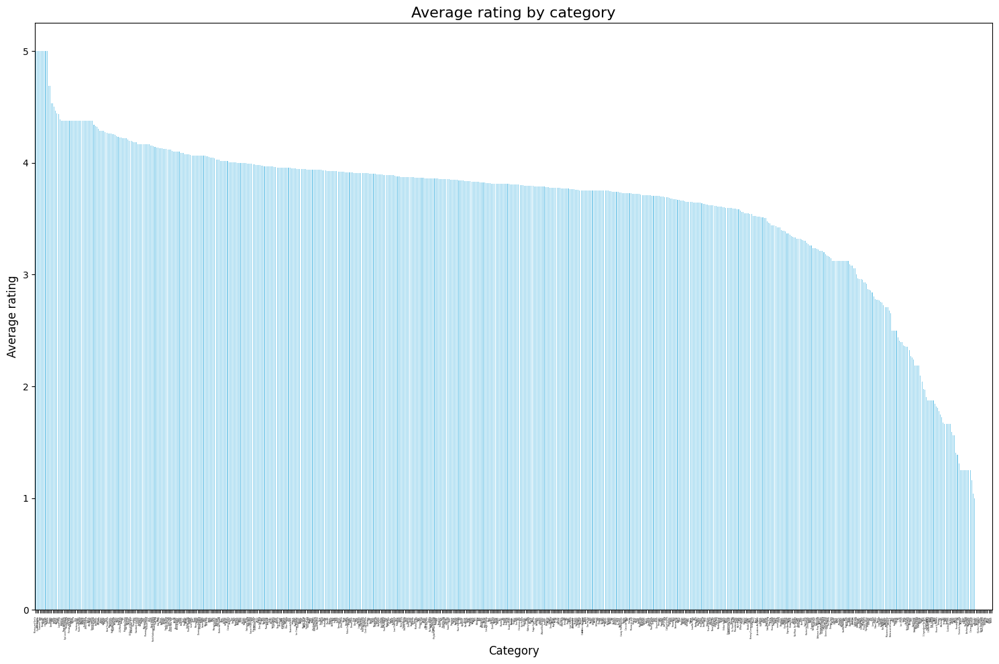

In [ ]:
# Plot of the average rating for all categories
df_exploded = df.explode('categories')

category_rating = df_exploded.groupby('categories')['rating'].mean().sort_values(ascending=False)

plt.figure(figsize=(15, 10))
category_rating.plot(kind='bar', color='skyblue')

plt.title('Average rating by category', fontsize=16)
plt.xlabel('Category', fontsize=12)
plt.ylabel('Average rating', fontsize=12)

plt.xticks(rotation=90, ha='center', fontsize=2)
plt.tight_layout()
plt.show()

The analysis of the relationship between categories and the target variable (rating) reveals several important insights. The first graph shows that the top 10 categories with the highest average ratings consistently achieve scores between 4.5 and 5. This indicates that certain categories are strongly associated with higher ratings, making them a valuable feature for the predictive model. Including these categories as variables can help the model identify patterns linked to high ratings.



The second graph highlights the most frequent categories in the dataset, with some, such as Bon Appetit and Peanut Free, appearing significantly more often than others. These frequent categories are likely to have a greater influence on the model simply due to their volume of data. However, this also raises the risk of bias, as the model could be disproportionately influenced by these common categories at the expense of less frequent ones.



The third graph shows the complete distribution of average ratings by category, where most categories tend to have lower ratings, while only a few achieve consistently high averages. This variability highlights the importance of the inclusion of this categories in the model.



Overall, categories are highly relevant for predicting ratings, but their impact depends on factors such as their frequency, average ratings, and distribution. To effectively incorporate this variable, it is important apply regularization techniques to prevent dominant categories from overpowering the model. Additionally, analyzing the importance of these variables in the model can help confirm their contribution to improving predictive performance. Categories are thus a valuable feature, but their inclusion requires thoughtful handling to ensure their maximum benefit.

STEP 2

In [ ]:
# Joint all text variables together
text_columns = ["directions", "categories", "desc", "title", "ingredients"]
df = df.dropna(subset=["rating"])
df["text"] = df[text_columns].fillna("").astype(str).apply(lambda row: " ".join(row), axis=1)


print(df["text"])

# Cross_vailidation
X = df["text"]
y = df["rating"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


0        ['1. Place the stock, lentils, celery, carrot,...
1        ['Combine first 9 ingredients in heavy medium ...
2        ['In a large heavy saucepan cook diced fennel ...
3        ['Heat oil in heavy large skillet over medium-...
4        ['Preheat oven to 350°F. Lightly grease 8x8x2-...
                               ...                        
20125    ['Beat whites in a bowl with an electric mixer...
20126    ['Bring broth to simmer in saucepan.Remove fro...
20127    ['Using a sharp knife, cut a shallow X in bott...
20128    ['Heat 2 tablespoons oil in heavy medium skill...
20129    ['Position rack in bottom third of oven and pr...
Name: text, Length: 20100, dtype: object


In [ ]:
print(X_train)
print(y_train)

3484     ['In a 5-quart kettle bring 4 quarts salted wa...
12285    ['Bring blueberries, 1/2 cup apple juice and s...
7081     ['Preheat broiler. Pierce eggplants all over w...
721      ['Whisk cream and buttermilk in a large bowl. ...
11903    ['Preheat oven to 375°F. Using long serrated k...
                               ...                        
11303    ['Whisk wine, shallots, mustard, 1/3 cup chopp...
11984    ['Combine 1 1/2 cups hot water and shiitake mu...
5399     ['Preheat oven to 350°F. Peel skin off top thi...
861      ['Blend sugar and vanilla bean in processor un...
15820    ['In large bowl, beat eggs until pale yellow a...
Name: text, Length: 16080, dtype: object
3484     2.500
12285    4.375
7081     3.125
721      5.000
11903    4.375
         ...  
11303    4.375
11984    4.375
5399     4.375
861      3.750
15820    4.375
Name: rating, Length: 16080, dtype: float64


In [ ]:
# Ntlk test preprocesing
nltk.download('punkt_tab')
nltk.download('stopwords')

def preprocess_text_nltk(text):
    text = text.lower()
    text = re.sub(r'[^\w\s]', '', text)
    tokens = word_tokenize(text)
    stop_words = set(stopwords.words("english"))
    filtered_tokens = [word for word in tokens if word not in stop_words]
    return " ".join(filtered_tokens)

X_train_proc = [preprocess_text_nltk(text) for text in X_train]
X_test_proc = [preprocess_text_nltk(text) for text in X_test]


[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
print(X_train[1])

['Combine first 9 ingredients in heavy medium saucepan. Add 3 shallots. Bring to simmer. Remove from heat, cover and let stand 30 minutes. Chill overnight.', 'Preheat oven to 325°F. Line 7-cup pâté or bread pan with plastic wrap. Melt butter in heavy small skillet over low heat. Add remaining 5 shallots. Cover and cook until very soft, stirring occasionally, about 15 minutes. Transfer to processor. Add pork, eggs, flour and Port and puree. Strain cream mixture, pressing on solids to extract as much liquid as possible. With processor running, add cream through feed tube and process just until combined with pork. Transfer to large bowl. Mix in currants.', 'Spoon mixture into prepared pan. Cover with foil. Place pan in large pan. Add boiling water to larger pan to within 1/2 inch of top of terrine. Bake until terrine begins to shrink from sides of pan and knife inserted into center comes out clean, about 1 1/2 hours. Uncover and cool on rack. Chill until cold. (Can be made 3 days ahead. C

In [ ]:
# TF-IDF vectorizer
vectorizer = TfidfVectorizer()

X_train_tfidf = vectorizer.fit_transform(X_train_proc)
X_test_tfidf = vectorizer.transform(X_test_proc)


In [ ]:
print(X_train_tfidf.shape)

(16080, 28811)


TF-IDF: The semantics of words are not considered.

Word Embeddings: Each word in the vocabulary is represented by a vector of components, and words with similar meanings will have similar embeddings. However, they lack context since each word is always assigned the same embedding.

Contextual Embeddings: These are more complex to compute (requiring the use of transformers) and provide the best results.

In [ ]:
# Word2vec model (training)
df =pd.DataFrame()
corpus = [text.split() for text in X_train]

model_w2v = Word2Vec(sentences=corpus, vector_size=512, window=5, min_count=1, workers=4)
words = list(model_w2v.wv.key_to_index)

In [ ]:
print(words) #Words learned by the model
print(model_w2v.wv[words[0]]) #Embeding for a random word

['and', 'to', 'the', 'in', 'a', 'with', 'until', "'1", 'cup', 'of', '1', 'tablespoons', 'or', "'2", 'into', 'about', 'large', 'over', 'teaspoon', "Free',", 'minutes.', '2', '1/2', 'Add', 'is', 'on', 'fresh', 'for', "'1/2", 'cups', 'salt', 'tablespoon', 'chopped', 'from', "'1/4", 'medium', 'at', 'then', 'heat', 'mixture', 'remaining', 'cut', '3', 'small', 'oil', 'be', 'bowl', 'baking', 'oven', "'3", 'water', 'teaspoons', 'it', 'are', 'lemon', 'Transfer', '5', 'minutes', '4', 'garlic', 'olive', 'heavy', 'each', 'chicken', "'Bon", 'stirring', 'pan', "oil',", 'skillet', '1/4', 'ground', "'Peanut", "'Soy", 'as', 'butter', "'4", "sugar',", 'add', "salt',", 'bowl.', 'finely', '(about', 'just', 'Nut', "'Tree", 'all', '10', 'cook', 'red', 'sugar', 'sauce', "'Vegetarian',", 'pepper', "chopped',", "['1", 'heat.', 'stir', 'Season', 'room', 'pepper.', 'up', 'Cover', 'cream', '&', "'Pescatarian',", 'can', "'Kosher']", "'3/4", 'dough', 'Stir', 'made', 'if', '6', "minutes.',", 'black', 'white', "'Quic

In [ ]:
# Converting words into Word2Vec embeddings for the max length.
def document_vector(text, model):
    words = text.split()
    word_vecs = [model.wv[word] for word in words if word in model.wv]
    if word_vecs:
        return np.mean(word_vecs, axis=0)
    else:
        return np.zeros(model.vector_size)

X_train_word2vec = np.array([document_vector(text, model_w2v) for text in X_train])
X_test_word2vec = np.array([document_vector(text, model_w2v) for text in X_test])

In [ ]:
print(X_train_word2vec.shape)

for text in X_train[:5]:
    print(text)
    print("/////////////////////////////////////////////////////////////")


(16080, 512)
['In a 5-quart kettle bring 4 quarts salted water to a boil for pasta.', 'In a small saucepan bring 1 1/2 cups water and tomatoes to a boil. Remove pan from heat and let tomatoes stand until softened, about 15 minutes. Drain tomatoes, reserving 1/2 cup soaking liquid, and chop. In a large bowl stir together tomatoes, reserved soaking liquid, olives, and parsley.', 'Cook pasta in boiling water until al dente, adding peas and zucchini during last minute of cooking. Drain pasta mixture well in a colander and add to tomato mixture with salt and pepper to taste, tossing until most of liquid is absorbed.'] ['Olive', 'Pasta', 'Tomato', 'Low Fat', 'Vegetarian', 'Quick & Easy', 'High Fiber', 'Pea', 'Zucchini', 'Spring', 'Gourmet'] Can be prepared in 45 minutes or less. Fusilli with Sun-Dried Tomatoes, Zucchini, and Peas  ['6 ounces fusilli or other spiral-shaped pasta', '1 1/2 cups water', '3/4 cup dried tomatoes (not packed in oil)', '1/4 cup Kalamata or other brine-cured black ol

In [ ]:
# Bert embbedings
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertModel.from_pretrained('bert-base-uncased')

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

def bert_embeddings(texts):
    tokens = tokenizer(texts, padding=True, truncation=True, max_length=512, return_tensors="pt").to(device)
    with torch.no_grad():
        outputs = model(**tokens)
    return outputs.last_hidden_state.mean(dim=1).cpu().numpy()

# Create the representations for the training and test sets
X_train_bert = np.array([bert_embeddings(text) for text in X_train])
X_test_bert = np.array([bert_embeddings(text) for text in X_test])


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [ ]:
# 1. Random Forest (TF_IDF)
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train_tfidf, y_train)
y_pred_rf_tfidf = rf.predict(X_test_tfidf)

KeyboardInterrupt: 

In [ ]:
# Evaluate random forest
mse = mean_squared_error(y_test, y_pred_rf_tfidf)
print("Random Forest tf_idf:")
print(f"mse: {mse}")
print(f"R^2: {r2_score(y_test, y_pred_rf_tfidf)}")

In [ ]:
# 1. Random Forest (Word2vec)
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train_word2vec, y_train)
y_pred_rf_word2vec = rf.predict(X_test_word2vec)

In [ ]:
# Evaluate random forest
mse = mean_squared_error(y_test, y_pred_rf_word2vec)
print("Random Forest word2vec:")
print(f"mse: {mse}")
print(f"R^2: {r2_score(y_test, y_pred_rf_word2vec)}")

In [ ]:
# 1. Random Forest (Bert)
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train_bert, y_train)
y_pred_rf_bert = rf.predict(X_test_bert)

In [ ]:
# Evaluate random forest
mse = mean_squared_error(y_test, y_pred_rf_bert)
print("Random Forest:")
print(f"mse: {mse}")
print(f"R^2: {r2_score(y_test, y_pred_rf_bert)}")

Random Forest:
mse: 1.3173477825715174
R^2: 0.28153012825595913


In [ ]:
# 2. SVM (TF-IDF)
svm = SVR()
svm.fit(X_train_tfidf, y_train)
y_pred_svm_tfidf = svm.predict(X_test_tfidf)

In [ ]:
# Evaluate SVM
mse = mean_squared_error(y_test, y_pred_svm_tfidf)
print("Random Forest:")
print(f"mse: {mse}")
print(f"R^2: {r2_score(y_test, y_pred_svm_tfidf)}")

In [ ]:
# 2. SVM (Word2vec)
svm = SVR()
svm.fit(X_train_word2vec, y_train)
y_pred_svm_word2vec = svm.predict(X_test_word2vec)

In [ ]:
# Evaluate SVM
mse = mean_squared_error(y_test, y_pred_svm_word2vec)
print("Random Forest:")
print(f"mse: {mse}")
print(f"R^2: {r2_score(y_test, y_pred_svm_word2vec)}")

Random Forest:
mse: 1.6477967282481156
R^2: 0.10130618530084212


In [ ]:
# 2. SVM (Bert)
svm = SVR()
X_train_bert_s = X_train_bert.squeeze(1)
X_test_bert_s = X_test_bert.squeeze(1)
print(X_train_bert_s.shape)
print(X_test_bert_s.shape)
svm.fit(X_train_bert_s, y_train)
y_pred_svm_bert = svm.predict(X_test_bert_s)

(16080, 768)
(4020, 768)


In [ ]:
# Evaluate SVM
mse = mean_squared_error(y_test, y_pred_svm_bert)
print("Random Forest:")
print(f"mse: {mse}")
print(f"R^2: {r2_score(y_test, y_pred_svm_bert)}")

Random Forest:
mse: 1.6631613665056346
R^2: 0.09292644699306996


Usando dispositivo: cuda


R^2: -5.079275826727989
Epoch 1/20
Train Loss: 13.8836, Val Loss: 10.8805, Val MSE: 10.8782


R^2: -1.4490717272362739
Epoch 2/20
Train Loss: 8.2831, Val Loss: 4.3836, Val MSE: 4.3823


R^2: -0.002983747320722596
Epoch 3/20
Train Loss: 3.8672, Val Loss: 1.7947, Val MSE: 1.7947


R^2: 0.0223335736761594
Epoch 4/20
Train Loss: 2.8659, Val Loss: 1.7494, Val MSE: 1.7494


R^2: -0.006452764604644168
Epoch 5/20
Train Loss: 2.6382, Val Loss: 1.8018, Val MSE: 1.8009


R^2: 0.05384790495164449
Epoch 6/20
Train Loss: 2.4415, Val Loss: 1.6934, Val MSE: 1.6930


R^2: 0.051647638915618854
Epoch 7/20
Train Loss: 2.3382, Val Loss: 1.6977, Val MSE: 1.6970


R^2: 0.045397575988015304
Epoch 8/20
Train Loss: 2.2908, Val Loss: 1.7090, Val MSE: 1.7082


R^2: 0.0526029165169174
Epoch 9/20
Train Loss: 2.1692, Val Loss: 1.6960, Val MSE: 1.6953


R^2: 0.0815807751892943
Epoch 10/20
Train Loss: 2.1034, Val Loss: 1.6443, Val MSE: 1.6434


R^2: 0.07863883780875647
Epoch 11/20
Train Loss: 2.0313, Val Loss: 1.6493, Val MSE: 1.6487


R^2: 0.10036006893338267
Epoch 12/20
Train Loss: 1.9855, Val Loss: 1.6108, Val MSE: 1.6098


R^2: 0.02883061119233077
Epoch 13/20
Train Loss: 1.9645, Val Loss: 1.7395, Val MSE: 1.7378


R^2: 0.0856141298824743
Epoch 14/20
Train Loss: 1.9486, Val Loss: 1.6369, Val MSE: 1.6362


R^2: 0.09224877910907148
Epoch 15/20
Train Loss: 1.9075, Val Loss: 1.6252, Val MSE: 1.6243


R^2: 0.09120064843631737
Epoch 16/20
Train Loss: 1.8929, Val Loss: 1.6268, Val MSE: 1.6262


R^2: 0.041351422237215774
Epoch 17/20
Train Loss: 1.8523, Val Loss: 1.7177, Val MSE: 1.7154


R^2: -0.1363054953499725
Epoch 18/20
Train Loss: 1.8353, Val Loss: 2.0339, Val MSE: 2.0333


R^2: -0.01255539177399334
Epoch 19/20
Train Loss: 1.8216, Val Loss: 1.8149, Val MSE: 1.8119


R^2: 0.08949968634834193
Epoch 20/20
Train Loss: 1.8150, Val Loss: 1.6298, Val MSE: 1.6292


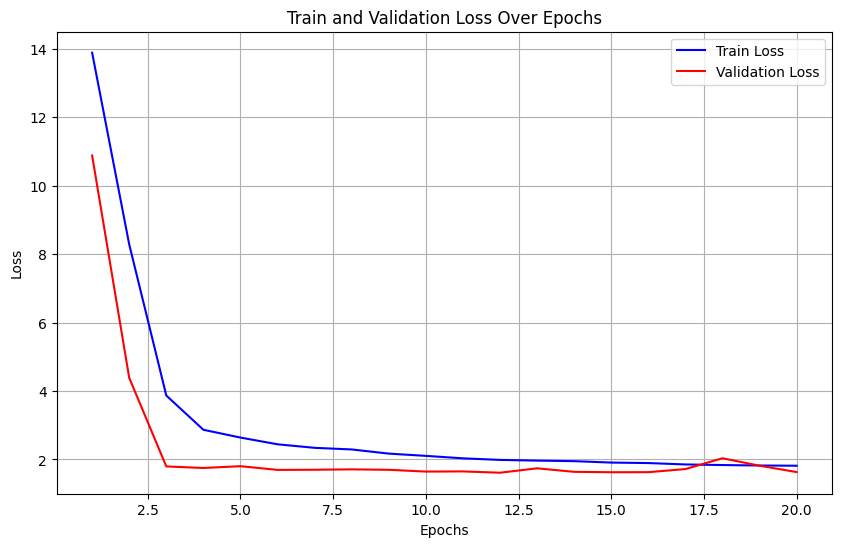

In [ ]:
# LSTM network training (Bert)
# Initial parameters
BATCH_SIZE = 16
EPOCHS = 20
LEARNING_RATE = 1e-4
EMBEDDING_SIZE = 768  # Embedding of Bert
HIDDEN_SIZE = 512
NUM_LAYERS = 4
OUTPUT_SIZE = 1

# Cross validation
X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train_bert, y_train, test_size=0.15, random_state=42
)

# Convert training and validation data to tensors
X_train_tensor = torch.tensor(X_train_final.squeeze(), dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_final.values, dtype=torch.float32)

X_val_tensor = torch.tensor(X_val.squeeze(), dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.float32)

# Add sequence dimension
X_train_tensor = X_train_tensor.unsqueeze(1)  # [N, 1, embedding_size]
X_val_tensor = X_val_tensor.unsqueeze(1)  # [N, 1, embedding_size]

# Dataset creation
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)

# Dataloader creation
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Test
X_test_tensor = torch.tensor(X_test_bert.squeeze(), dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.float32)

X_test_tensor = X_test_tensor.unsqueeze(1)

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Usando dispositivo: {device}")


class LSTMModel(nn.Module):
    def __init__(self, embedding_size, hidden_size, num_layers, output_size):
        super(LSTMModel, self).__init__()
        # LSTM bidireccional
        self.lstm = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.5, bidirectional=True)

        # Fully conected network
        self.fc = nn.Sequential(
            nn.Linear(hidden_size * 2, 512),
            nn.ReLU(),
            nn.BatchNorm1d(512),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(0.4),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Dropout(0.3),
            nn.Linear(128, output_size)
        )

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        # Take the last output of the LSTL;
        final_feature_map = lstm_out[:, -1, :]
        output = self.fc(final_feature_map)
        return output.squeeze(-1)


# Create the model
model = LSTMModel(EMBEDDING_SIZE, HIDDEN_SIZE, NUM_LAYERS, OUTPUT_SIZE)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)


# Epoch
def train_epoch(model, data_loader, optimizer, criterion, device):
    model.train()
    losses = []
    J_it = 0;
    # tqdm to show the progress
    for step, batch in enumerate(tqdm(data_loader, desc="Training", leave=False)):
        embeddings, labels = batch
        embeddings, labels = embeddings.to(device), labels.to(device)

        predictions = model(embeddings)

        loss = criterion(predictions, labels)
        losses.append(loss.item())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    return sum(losses) / len(losses)

# Validation function
def eval_model(model, data_loader, criterion, device):
    model.eval()
    losses = []
    predictions = []
    actuals = []

    with torch.no_grad():
        for batch in data_loader:
            embeddings, labels = batch

            embeddings, labels = embeddings.to(device), labels.to(device)

            preds = model(embeddings)

            loss = criterion(preds, labels)
            losses.append(loss.item())

            predictions.extend(preds.cpu().numpy())
            actuals.extend(labels.cpu().numpy())

    print(f"R^2: {r2_score(actuals, predictions)}")
    mse = mean_squared_error(actuals, predictions)
    return sum(losses) / len(losses), mse

train_losses = []
val_losses = []

# Loop of training and validation
for epoch in range(EPOCHS):
    train_loss = train_epoch(model, train_loader, optimizer, criterion, device)

    val_loss, val_mse = eval_model(model, val_loader, criterion, device)

    train_losses.append(train_loss)
    val_losses.append(val_loss)

    print(f"Epoch {epoch + 1}/{EPOCHS}")
    print(f"Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, Val MSE: {val_mse:.4f}")

# Loss plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, EPOCHS + 1), train_losses, label='Train Loss', color='blue')
plt.plot(range(1, EPOCHS + 1), val_losses, label='Validation Loss', color='red')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Train and Validation Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

# Save the model
torch.save(model.state_dict(), "model_lstm_1_bert.pth")


In [ ]:
# Evaluate the model with test data
def evaluate_model_on_test(model, test_loader, criterion, device):
    model.eval()
    losses = []
    predictions = []
    actuals = []

    with torch.no_grad():
        for batch in test_loader:
            embeddings, labels = batch

            embeddings, labels = embeddings.to(device), labels.to(device)

            preds = model(embeddings)

            loss = criterion(preds, labels)
            losses.append(loss.item())

            predictions.extend(preds.cpu().numpy())
            actuals.extend(labels.cpu().numpy())

    r2 = r2_score(actuals, predictions)

    mse = mean_squared_error(actuals, predictions)

    # Average loss
    avg_loss = sum(losses) / len(losses)

    print(f"Test Loss: {avg_loss:.4f}")
    print(f"Test MSE: {mse:.4f}")
    print(f"Test R²: {r2:.4f}")

    return avg_loss, mse, r2
model.load_state_dict(torch.load("model_lstm_1_bert.pth"))

model = model.to(device)


test_loss, test_mse, test_r2 = evaluate_model_on_test(model, test_loader, criterion, device)

print(f"Test Metrics: \nMSE: {test_mse:.4f}, R²: {test_r2:.4f}")

Test Loss: 1.5678
Test MSE: 1.5706
Test R²: 0.1434
Test Metrics: 
MSE: 1.5706, R²: 0.1434


Usando dispositivo: cuda


R^2: -4.876847560094477
Epoch 1/5
Train Loss: 14.3628, Val Loss: 10.5191, Val MSE: 10.5160


R^2: -1.8222202435429513
Epoch 2/5
Train Loss: 8.4957, Val Loss: 5.0524, Val MSE: 5.0501


R^2: -0.19696123616175298
Epoch 3/5
Train Loss: 3.7491, Val Loss: 2.1421, Val MSE: 2.1418


R^2: -0.030109697721248496
Epoch 4/5
Train Loss: 2.6955, Val Loss: 1.8429, Val MSE: 1.8433


R^2: -0.021973992392406716
Epoch 5/5
Train Loss: 2.5554, Val Loss: 1.8286, Val MSE: 1.8287


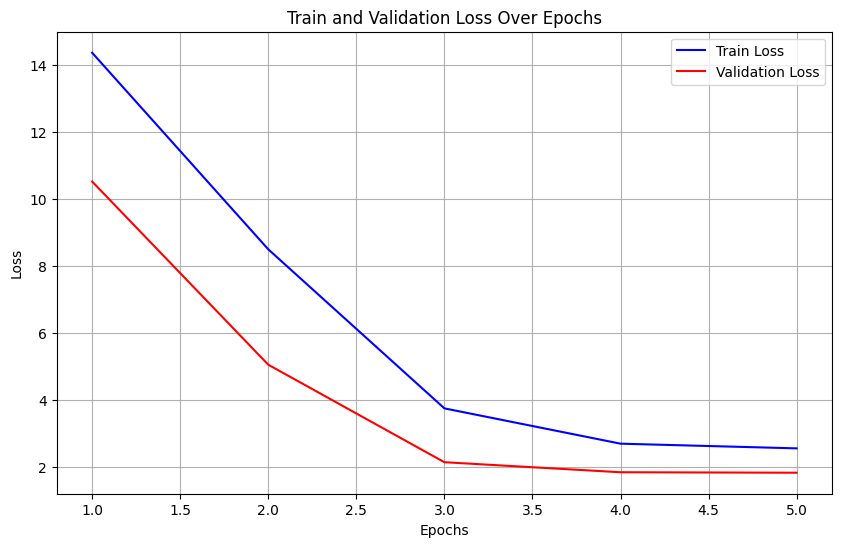

In [ ]:
# LSTM network training (Word2vec)
# Initial parameters
BATCH_SIZE = 16
EPOCHS = 5
LEARNING_RATE = 1e-4
EMBEDDING_SIZE = 512 # Word2vec embbeding
HIDDEN_SIZE = 512
NUM_LAYERS = 4
OUTPUT_SIZE = 1

X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train_word2vec, y_train, test_size=0.15, random_state=42
)

X_train_tensor = torch.tensor(X_train_final.squeeze(), dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_final.values, dtype=torch.float32)

X_val_tensor = torch.tensor(X_val.squeeze(), dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.float32)

X_train_tensor = X_train_tensor.unsqueeze(1)  # [N, 1, embedding_size]
X_val_tensor = X_val_tensor.unsqueeze(1)  # [N, 1, embedding_size]

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

X_test_tensor = torch.tensor(X_test_word2vec.squeeze(), dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.float32)

X_test_tensor = X_test_tensor.unsqueeze(1)

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Usando dispositivo: {device}")


class LSTMModel(nn.Module):
    def __init__(self, embedding_size, hidden_size, num_layers, output_size):
        super(LSTMModel, self).__init__()
        # LSTM bidireccional
        self.lstm = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.5, bidirectional=True)

        # Fully conected network
        self.fc = nn.Sequential(
            nn.Linear(hidden_size * 2, 512),
            nn.ReLU(),
            nn.BatchNorm1d(512),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(0.4),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Dropout(0.3),
            nn.Linear(128, output_size)
        )

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        # Last output of the LSTM
        final_feature_map = lstm_out[:, -1, :]
        output = self.fc(final_feature_map)
        return output.squeeze(-1)


# Create the model
model = LSTMModel(EMBEDDING_SIZE, HIDDEN_SIZE, NUM_LAYERS, OUTPUT_SIZE)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

from tqdm import tqdm

def train_epoch(model, data_loader, optimizer, criterion, device):
    model.train()
    losses = []
    J_it = 0;
    for step, batch in enumerate(tqdm(data_loader, desc="Training", leave=False)):
        embeddings, labels = batch
        embeddings, labels = embeddings.to(device), labels.to(device)

        predictions = model(embeddings)

        loss = criterion(predictions, labels)
        losses.append(loss.item())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    return sum(losses) / len(losses)

# Validation function
def eval_model(model, data_loader, criterion, device):
    model.eval()
    losses = []
    predictions = []
    actuals = []

    with torch.no_grad():
        for batch in data_loader:
            embeddings, labels = batch

            embeddings, labels = embeddings.to(device), labels.to(device)

            preds = model(embeddings)

            loss = criterion(preds, labels)
            losses.append(loss.item())

            predictions.extend(preds.cpu().numpy())
            actuals.extend(labels.cpu().numpy())

    print(f"R^2: {r2_score(actuals, predictions)}")
    mse = mean_squared_error(actuals, predictions)
    return sum(losses) / len(losses), mse

train_losses = []
val_losses = []

# Loop of training and validation
for epoch in range(EPOCHS):
    train_loss = train_epoch(model, train_loader, optimizer, criterion, device)

    # Validación de la época
    val_loss, val_mse = eval_model(model, val_loader, criterion, device)

    # Almacenar las pérdidas
    train_losses.append(train_loss)
    val_losses.append(val_loss)

    print(f"Epoch {epoch + 1}/{EPOCHS}")
    print(f"Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, Val MSE: {val_mse:.4f}")

# Graficar las pérdidas de entrenamiento y validación
plt.figure(figsize=(10, 6))
plt.plot(range(1, EPOCHS + 1), train_losses, label='Train Loss', color='blue')
plt.plot(range(1, EPOCHS + 1), val_losses, label='Validation Loss', color='red')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Train and Validation Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

# Guardar el modelo
torch.save(model.state_dict(), "model_lstm_1_w2v.pth")

In [ ]:
# Network evaluation with test data
def evaluate_model_on_test(model, test_loader, criterion, device):
    model.eval()
    losses = []
    predictions = []
    actuals = []

    with torch.no_grad():
        for batch in test_loader:
            embeddings, labels = batch

            embeddings, labels = embeddings.to(device), labels.to(device)

            preds = model(embeddings)

            loss = criterion(preds, labels)
            losses.append(loss.item())

            predictions.extend(preds.cpu().numpy())
            actuals.extend(labels.cpu().numpy())

    r2 = r2_score(actuals, predictions)

    mse = mean_squared_error(actuals, predictions)

    avg_loss = sum(losses) / len(losses)

    print(f"Test Loss: {avg_loss:.4f}")
    print(f"Test MSE: {mse:.4f}")
    print(f"Test R²: {r2:.4f}")

    return avg_loss, mse, r2

model.load_state_dict(torch.load("model_lstm_1_w2v.pth"))

model = model.to(device)

test_loss, test_mse, test_r2 = evaluate_model_on_test(model, test_loader, criterion, device)

print(f"Test Metrics: \nMSE: {test_mse:.4f}, R²: {test_r2:.4f}")

<ipython-input-21-9099dfea9a21>:39: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("modelo_lstm.pth"))


Test Loss: 1.7639
Test MSE: 1.7676
Test R²: 0.0359
Test Metrics: 
MSE: 1.7676, R²: 0.0359


SEPARATE VARIABLES

In [ ]:
# Separate variables strategy
df = pd.read_json('full_format_recipes.json')
df = df.dropna(subset=["rating"])

# Split the DataFrame in X (inputs) and y (outpus)
text_columns = ["directions", "categories", "desc", "title", "ingredients"]
X = df[text_columns]  # All text colums
y = df['rating']

# Split the data X_train, X_test, y_train, y_test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)



In [ ]:
# Word2vec procedure for each text variable
def train_word2vec_model(text_data, vector_size=100):
    tokenized_texts = [str(text).split() for text in text_data]
    model = Word2Vec(tokenized_texts, vector_size=vector_size, window=5, min_count=1, workers=4)
    return model

def document_vector(text, model):
    if not isinstance(text, str):
        text = str(text)

    words = text.split()
    word_vecs = [model.wv[word] for word in words if word in model.wv]
    if word_vecs:
        return np.mean(word_vecs, axis=0)
    else:
        return np.zeros(model.vector_size)

word2vec_models = {}
X_train_word2vec = {}
X_test_word2vec = {}

for col in text_columns:
    word2vec_models[col] = train_word2vec_model(X_train[col])

    X_train_word2vec[col] = np.array([document_vector(text, word2vec_models[col]) for text in X_train[col]])
    X_test_word2vec[col] = np.array([document_vector(text, word2vec_models[col]) for text in X_test[col]])



In [ ]:
print(type(X_train_final))

<class 'numpy.ndarray'>


In [ ]:
# Convert to tensors
x_train_directions = torch.tensor(X_train_word2vec["directions"], dtype=torch.float32)
x_train_categories = torch.tensor(X_train_word2vec["categories"], dtype=torch.float32)
x_train_desc = torch.tensor(X_train_word2vec["desc"], dtype=torch.float32)
x_train_title = torch.tensor(X_train_word2vec["title"], dtype=torch.float32)
x_train_ingredients = torch.tensor(X_train_word2vec["ingredients"], dtype=torch.float32)

# Add the number of classes dimension
x_train_directions = x_train_directions.unsqueeze(1)
x_train_categories = x_train_categories.unsqueeze(1)
x_train_desc = x_train_desc.unsqueeze(1)
x_train_title = x_train_title.unsqueeze(1)
x_train_ingredients = x_train_ingredients.unsqueeze(1)

# Test
x_test_directions = torch.tensor(X_test_word2vec["directions"], dtype=torch.float32)
x_test_categories = torch.tensor(X_test_word2vec["categories"], dtype=torch.float32)
x_test_desc = torch.tensor(X_test_word2vec["desc"], dtype=torch.float32)
x_test_title = torch.tensor(X_test_word2vec["title"], dtype=torch.float32)
x_test_ingredients = torch.tensor(X_test_word2vec["ingredients"], dtype=torch.float32)

x_test_directions = x_test_directions.unsqueeze(1)
x_test_categories = x_test_categories.unsqueeze(1)
x_test_desc = x_test_desc.unsqueeze(1)
x_test_title = x_test_title.unsqueeze(1)
x_test_ingredients = x_test_ingredients.unsqueeze(1)

# Dataloader
train_dataset = TensorDataset(x_train_directions, x_train_categories, x_train_desc, x_train_title, x_train_ingredients, torch.tensor(y_train.values, dtype=torch.long))
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True)

test_dataset = TensorDataset(x_test_directions, x_test_categories, x_test_desc, x_test_title, x_test_ingredients, torch.tensor(y_test.values, dtype=torch.long))
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=False)


Epoch 1/5:  20%|██        | 101/503 [00:26<00:46,  8.56batch/s, loss=11.8]

Epoch [1/5], Batch [100/503], Loss: 11.4359


Epoch 1/5:  40%|███▉      | 201/503 [00:41<00:36,  8.23batch/s, loss=7.53]

Epoch [1/5], Batch [200/503], Loss: 8.0786


Epoch 1/5:  60%|█████▉    | 301/503 [00:59<00:34,  5.89batch/s, loss=4.49]

Epoch [1/5], Batch [300/503], Loss: 4.4360


Epoch 1/5:  80%|███████▉  | 401/503 [01:10<00:12,  8.26batch/s, loss=3.36]

Epoch [1/5], Batch [400/503], Loss: 3.5173


Epoch 1/5: 100%|█████████▉| 502/503 [01:18<00:00, 13.42batch/s, loss=2.43]

Epoch [1/5], Batch [500/503], Loss: 2.7221


Epoch 1/5: 100%|██████████| 503/503 [01:18<00:00,  6.44batch/s, loss=1.59]


Epoch [1/5], MSE: 1.8840


Epoch 2/5:  20%|██        | 103/503 [00:09<00:29, 13.62batch/s, loss=1.75]

Epoch [2/5], Batch [100/503], Loss: 2.0349


Epoch 2/5:  40%|███▉      | 201/503 [00:17<00:23, 13.08batch/s, loss=2.56]

Epoch [2/5], Batch [200/503], Loss: 2.0158


Epoch 2/5:  60%|██████    | 302/503 [00:27<00:16, 12.54batch/s, loss=2.13]

Epoch [2/5], Batch [300/503], Loss: 1.6242


Epoch 2/5:  80%|███████▉  | 401/503 [00:36<00:12,  8.40batch/s, loss=2.34]

Epoch [2/5], Batch [400/503], Loss: 1.9998


Epoch 2/5: 100%|█████████▉| 502/503 [00:45<00:00, 12.68batch/s, loss=2.32]

Epoch [2/5], Batch [500/503], Loss: 1.7902


Epoch 2/5: 100%|██████████| 503/503 [00:46<00:00, 10.92batch/s, loss=1.95]


Epoch [2/5], MSE: 1.7411


Epoch 3/5:  20%|██        | 102/503 [00:10<00:31, 12.66batch/s, loss=1.48]

Epoch [3/5], Batch [100/503], Loss: 1.9883


Epoch 3/5:  40%|███▉      | 201/503 [00:23<00:40,  7.46batch/s, loss=2.1]

Epoch [3/5], Batch [200/503], Loss: 2.2670


Epoch 3/5:  60%|█████▉    | 301/503 [00:32<00:16, 12.16batch/s, loss=2.65]

Epoch [3/5], Batch [300/503], Loss: 1.0432


Epoch 3/5:  80%|███████▉  | 401/503 [00:42<00:13,  7.74batch/s, loss=1.58]

Epoch [3/5], Batch [400/503], Loss: 1.0240


Epoch 3/5: 100%|█████████▉| 501/503 [00:50<00:00, 12.88batch/s, loss=2.41]

Epoch [3/5], Batch [500/503], Loss: 2.4173


Epoch 3/5: 100%|██████████| 503/503 [00:50<00:00,  9.90batch/s, loss=2.39]


Epoch [3/5], MSE: 1.7652


Epoch 4/5:  20%|██        | 101/503 [00:10<00:32, 12.46batch/s, loss=2.59]

Epoch [4/5], Batch [100/503], Loss: 2.5582


Epoch 4/5:  40%|███▉      | 201/503 [00:18<00:30,  9.98batch/s, loss=1.74]

Epoch [4/5], Batch [200/503], Loss: 1.4594


Epoch 4/5:  60%|█████▉    | 301/503 [00:28<00:15, 12.97batch/s, loss=2.21]

Epoch [4/5], Batch [300/503], Loss: 1.5761


Epoch 4/5:  80%|███████▉  | 401/503 [00:37<00:11,  9.10batch/s, loss=1.84]

Epoch [4/5], Batch [400/503], Loss: 1.9608


Epoch 4/5: 100%|█████████▉| 501/503 [00:49<00:00, 12.73batch/s, loss=1.73]

Epoch [4/5], Batch [500/503], Loss: 2.0131


Epoch 4/5: 100%|██████████| 503/503 [00:49<00:00, 10.12batch/s, loss=1.11]


Epoch [4/5], MSE: 1.7573


Epoch 5/5:  20%|██        | 101/503 [00:09<00:46,  8.57batch/s, loss=1.52]

Epoch [5/5], Batch [100/503], Loss: 1.8722


Epoch 5/5:  40%|████      | 202/503 [00:18<00:24, 12.08batch/s, loss=2.09]

Epoch [5/5], Batch [200/503], Loss: 2.6745


Epoch 5/5:  60%|█████▉    | 301/503 [00:28<00:26,  7.59batch/s, loss=1.21]

Epoch [5/5], Batch [300/503], Loss: 1.7549


Epoch 5/5:  80%|███████▉  | 402/503 [00:37<00:08, 12.13batch/s, loss=2.38]

Epoch [5/5], Batch [400/503], Loss: 1.9765


Epoch 5/5: 100%|█████████▉| 501/503 [00:48<00:00, 12.28batch/s, loss=1.78]

Epoch [5/5], Batch [500/503], Loss: 1.9359


Epoch 5/5: 100%|██████████| 503/503 [00:48<00:00, 10.42batch/s, loss=1.22]


Epoch [5/5], MSE: 1.7722


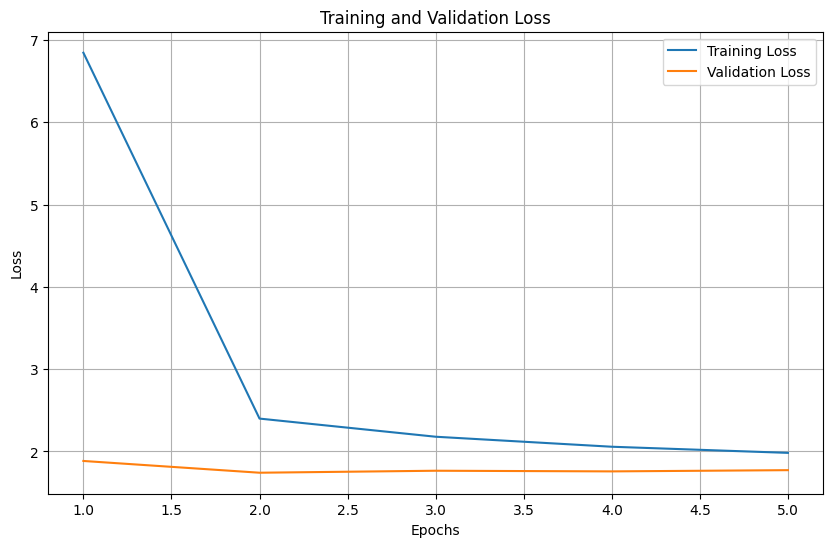

In [13]:
# Training and validating LSTM network with separate input data
class LSTMModel(nn.Module):
    def __init__(self, embedding_size, hidden_size, num_layers, output_size):
        super(LSTMModel, self).__init__()

        # LSTM for each of the 5 text colums
        self.lstm_directions = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_categories = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_desc = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_title = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_ingredients = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)

        self.fc = nn.Sequential(
            nn.Linear(hidden_size * 10, 512),  # 5 inputs * 2 (bidireccional) * hidden_size
            nn.ReLU(),
            nn.BatchNorm1d(512),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(0.4),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Dropout(0.3),
            nn.Linear(128, output_size)
        )

    def forward(self, x_directions, x_categories, x_desc, x_title, x_ingredients):
        lstm_out_directions, _ = self.lstm_directions(x_directions)
        lstm_out_categories, _ = self.lstm_categories(x_categories)
        lstm_out_desc, _ = self.lstm_desc(x_desc)
        lstm_out_title, _ = self.lstm_title(x_title)
        lstm_out_ingredients, _ = self.lstm_ingredients(x_ingredients)

        # Concatenate the outputs of all LSTMs
        concatenated = torch.cat([lstm_out_directions[:, -1, :], lstm_out_categories[:, -1, :],
                                 lstm_out_desc[:, -1, :], lstm_out_title[:, -1, :], lstm_out_ingredients[:, -1, :]], dim=1)

        # Step through fully connected layers
        out = self.fc(concatenated)
        return out

# Create the model
model = LSTMModel(embedding_size=100, hidden_size=128, num_layers=2, output_size=1)  # Ajusta el tamaño de salida según el número de clases

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)

# Training
num_epochs = 5

train_losses = []
val_losses = []

for epoch in range(num_epochs):
    model.train()
    J_it = 0.0

    with tqdm(train_dataloader, desc=f"Epoch {epoch+1}/{num_epochs}", unit="batch") as tepoch:
        for batch_idx, batch in enumerate(tepoch):
            x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch, labels_batch = batch
            optimizer.zero_grad()

            labels_batch = labels_batch.float()

            outputs = model(x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch)
            loss = criterion(outputs, labels_batch)

            loss.backward()
            optimizer.step()

            J_it += loss.item()

            tepoch.set_postfix(loss=loss.item())

            # Shows the progress for each 100 steps.
            if (batch_idx + 1) % 100 == 0:
                print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{batch_idx+1}/{len(train_dataloader)}], Loss: {loss.item():.4f}")

    train_loss = J_it / len(train_dataloader)
    train_losses.append(train_loss)

    # Validating for each epoch
    model.eval()
    with torch.no_grad():
        total_loss = 0.0
        for batch in test_dataloader:
            x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch, labels_batch = batch
            outputs = model(x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch)

            loss = criterion(outputs.squeeze(), labels_batch)
            total_loss += loss.item()

    avg_loss = total_loss / len(test_dataloader)
    val_losses.append(avg_loss)

    print(f'Epoch [{epoch+1}/{num_epochs}], MSE: {avg_loss:.4f}')

# Loss plot
epochs = range(1, num_epochs + 1)
plt.figure(figsize=(10, 6))
plt.plot(epochs, train_losses, label='Training Loss')
plt.plot(epochs, val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid()
plt.show()
torch.save(model.state_dict(), "model_lstm_5_w2v.pth")

In [ ]:
# Evaluate the model
def evaluate_model(model, dataloader, criterion, task="regression", device="cuda"):

    model.eval()
    model.to(device)

    total_loss = 0.0
    all_labels = []
    all_predictions = []

    with torch.no_grad():
        for batch in dataloader:

            x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch, labels_batch = batch

            x_directions_batch = x_directions_batch.to(device)
            x_categories_batch = x_categories_batch.to(device)
            x_desc_batch = x_desc_batch.to(device)
            x_title_batch = x_title_batch.to(device)
            x_ingredients_batch = x_ingredients_batch.to(device)
            labels_batch = labels_batch.to(device)

            outputs = model(
                x_directions_batch,
                x_categories_batch,
                x_desc_batch,
                x_title_batch,
                x_ingredients_batch
            )

            loss = criterion(outputs.squeeze(), labels_batch)
            total_loss += loss.item()

            all_labels.extend(labels_batch.cpu().numpy())
            if task == "classification":
                predictions = torch.sigmoid(outputs).cpu().numpy()
                predictions = (predictions > 0.5).astype(int)
            else:
                predictions = outputs.squeeze().cpu().numpy()

            all_predictions.extend(predictions)

    avg_loss = total_loss / len(dataloader)
    metrics = {"loss": avg_loss}

    if task == "classification":
        metrics["accuracy"] = accuracy_score(all_labels, all_predictions)
        metrics["f1_score"] = f1_score(all_labels, all_predictions, average="weighted")
    else:
        metrics["mse"] = mean_squared_error(all_labels, all_predictions)
        metrics["rmse"] = mean_squared_error(all_labels, all_predictions, squared=False)
        metrics["r2"] = r2_score(all_labels, all_predictions)

    return metrics

metrics = evaluate_model(model, test_dataloader, criterion, task="regression", device="cuda")

# Show metrics
print("Resultados de la evaluación:")
for key, value in metrics.items():
    print(f"{key}: {value:.4f}")

Resultados de la evaluación:
loss: 1.7698
mse: 1.7722
rmse: 1.3313
r2: -0.0032


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


The network is able to learn up to 5 epochs, after which it starts to overfit.

In [ ]:
# Bert embbedings
df = pd.read_json('full_format_recipes.json')
df = df.dropna(subset=["rating"])

text_columns = ["directions", "categories", "desc", "title", "ingredients"]
X = df[text_columns]
y = df['rating']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Load Bert model
bert_model_name = 'bert-base-uncased'
tokenizer = BertTokenizer.from_pretrained(bert_model_name)
bert_model = BertModel.from_pretrained(bert_model_name)

# Function to obtain Bert embbedings
@torch.no_grad()
def get_bert_embeddings(texts):
    inputs = tokenizer.batch_encode_plus(texts, padding=True, truncation=True, return_tensors="pt", max_length=512)
    outputs = bert_model(**inputs)

    cls_embeddings = outputs.last_hidden_state[:, 0, :]
    return cls_embeddings

X_train_bert = {}
X_test_bert = {}

for col in text_columns:
    X_train_bert[col] = get_bert_embeddings(X_train[col].astype(str).tolist())
    X_test_bert[col] = get_bert_embeddings(X_test[col].astype(str).tolist())


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Procesando columna: directions


In [ ]:
# Training and test separated variables (bert)
y_train_tensor = torch.tensor(y_train.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.float32)

train_tensors = [X_train_bert[col] for col in text_columns]
test_tensors = [X_test_bert[col] for col in text_columns]

train_dataset = TensorDataset(*train_tensors, y_train_tensor)
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True)

test_dataset = TensorDataset(*test_tensors, y_test_tensor)
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=False)

class LSTMModel(nn.Module):
    def __init__(self, embedding_size, hidden_size, num_layers, output_size):
        super(LSTMModel, self).__init__()

        self.lstm_directions = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_categories = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_desc = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_title = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)
        self.lstm_ingredients = nn.LSTM(embedding_size, hidden_size, num_layers, batch_first=True, dropout=0.25, bidirectional=True)

        self.fc = nn.Sequential(
            nn.Linear(hidden_size * 10, 512),  # 5 inputs * 2 (bidireccional) * hidden_size
            nn.ReLU(),
            nn.BatchNorm1d(512),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(0.4),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Dropout(0.3),
            nn.Linear(128, output_size)
        )

    def forward(self, x_directions, x_categories, x_desc, x_title, x_ingredients):
        lstm_out_directions, _ = self.lstm_directions(x_directions)
        lstm_out_categories, _ = self.lstm_categories(x_categories)
        lstm_out_desc, _ = self.lstm_desc(x_desc)
        lstm_out_title, _ = self.lstm_title(x_title)
        lstm_out_ingredients, _ = self.lstm_ingredients(x_ingredients)

        concatenated = torch.cat([lstm_out_directions[:, -1, :], lstm_out_categories[:, -1, :],
                                 lstm_out_desc[:, -1, :], lstm_out_title[:, -1, :], lstm_out_ingredients[:, -1, :]], dim=1)

        out = self.fc(concatenated)
        return out

# Create the model
model = LSTMModel(embedding_size=100, hidden_size=128, num_layers=2, output_size=1)  # Ajusta el tamaño de salida según el número de clases

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)

# Training
num_epochs = 5
from tqdm import tqdm

train_losses = []
test_losses = []

for epoch in range(num_epochs):
    model.train()
    epoch_train_loss = 0.0

    with tqdm(train_dataloader, desc=f"Epoch {epoch+1}/{num_epochs}", unit="batch") as tepoch:
        for batch_idx, batch in enumerate(tepoch):
            x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch, labels_batch = batch
            optimizer.zero_grad()

            labels_batch = labels_batch.float()

            outputs = model(x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch)
            loss = criterion(outputs, labels_batch)

            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()

            tepoch.set_postfix(loss=loss.item())

    avg_train_loss = epoch_train_loss / len(train_dataloader)
    train_losses.append(avg_train_loss)

  # Validation
    model.eval()
    epoch_test_loss = 0.0
    with torch.no_grad():
        for batch in test_dataloader:
            x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch, labels_batch = batch
            outputs = model(x_directions_batch, x_categories_batch, x_desc_batch, x_title_batch, x_ingredients_batch)

            loss = criterion(outputs.squeeze(), labels_batch)
            epoch_test_loss += loss.item()

    avg_test_loss = epoch_test_loss / len(test_dataloader)
    test_losses.append(avg_test_loss)

    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Test Loss: {avg_test_loss:.4f}")

print("\nPérdidas de entrenamiento por época:", train_losses)
print("Pérdidas de prueba por época:", test_losses)


torch.save(model.state_dict(), "model_lstm_1_bert.pth")

Hugging face

In [ ]:
# Data of hugging face
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=1)
model = model.to(device)

X_train_l = X_train.tolist()
X_test_l = X_test.tolist()

train_encodings = tokenizer(X_train_l, truncation=True, padding=True, max_length=128, return_tensors="pt")
test_encodings = tokenizer(X_test_l, truncation=True, padding=True, max_length=128, return_tensors="pt")

y_train_t = torch.tensor(y_train.values).float()
y_test_t = torch.tensor(y_test.values).float()

Using device: cuda


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
print(X_train)

["['In a 5-quart kettle bring 4 quarts salted water to a boil for pasta.', 'In a small saucepan bring 1 1/2 cups water and tomatoes to a boil. Remove pan from heat and let tomatoes stand until softened, about 15 minutes. Drain tomatoes, reserving 1/2 cup soaking liquid, and chop. In a large bowl stir together tomatoes, reserved soaking liquid, olives, and parsley.', 'Cook pasta in boiling water until al dente, adding peas and zucchini during last minute of cooking. Drain pasta mixture well in a colander and add to tomato mixture with salt and pepper to taste, tossing until most of liquid is absorbed.'] ['Olive', 'Pasta', 'Tomato', 'Low Fat', 'Vegetarian', 'Quick & Easy', 'High Fiber', 'Pea', 'Zucchini', 'Spring', 'Gourmet'] Can be prepared in 45 minutes or less. Fusilli with Sun-Dried Tomatoes, Zucchini, and Peas  ['6 ounces fusilli or other spiral-shaped pasta', '1 1/2 cups water', '3/4 cup dried tomatoes (not packed in oil)', '1/4 cup Kalamata or other brine-cured black olives, pitte

In [ ]:
# Prepare dataset for Hugging Face
class Dataset(Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        item['labels'] = torch.tensor(self.labels[idx])
        return item

    def __len__(self):
        return len(self.labels)

train_dataset = Dataset(train_encodings, y_train_t)
test_dataset = Dataset(test_encodings, y_test_t)

In [ ]:
import wandb
wandb.login(key="fc60e8ee3e227213d161c45cbd925e2c30e3a9d6")

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
# Initial configuration
model.to(device)
training_args = TrainingArguments(
  output_dir='./results',  # Output directory
  num_train_epochs=1,  # Number of epochs
  per_device_train_batch_size=16,  # Training batch size
  per_device_eval_batch_size=64,  # Evaluation batch size
  warmup_steps=100,  # Warmup steps
  weight_decay=5e-5,  # Weight decay
  logging_dir='./logs',  # Logs directory
  logging_steps=10,
  learning_rate=5e-5,
  report_to="wandb",  # Report to W&B
  run_name="my_transformer_run",  # Custom run name in W&B
  evaluation_strategy="steps",  # Evaluate at the end of each epoch
  eval_steps=500,  # If you use "epoch", eval_steps is not needed
  load_best_model_at_end=True,  # Load the best model at the end
  metric_for_best_model="loss",  # Select metric for the best model
)

# Trainer with data and model
trainer = Trainer(
  model=model,  # Pre-trained model
  args=training_args,  # Training arguments
  train_dataset=train_dataset,  # Training dataset
  eval_dataset=test_dataset  # Evaluation dataset
)

# Start fine-tuning
trainer.train()

<ipython-input-108-ae996d79f0c3>:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
<ipython-input-108-ae996d79f0c3>:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  item['labels'] = torch.tensor(self.labels[idx])


Step,Training Loss,Validation Loss
500,2.134800,1.627850


In [ ]:
# Evaluate the model
trainer.evaluate()

# Save the fine-tuned model
model.save_pretrained('./fine-tuned-bert')
tokenizer.save_pretrained('./fine-tuned-bert')

EXTENSION

In [ ]:
from transformers import pipeline
from joblib import Parallel, delayed
import pandas as pd
# Sumarizer

df = pd.read_json('full_format_recipes.json')

# Filter out rows with null directions
df = df[df['directions'].notna()]

df['directions_text'] = df['directions'].apply(lambda x: " ".join(x) if isinstance(x, list) else str(x))

# Initialize the summarization pipeline
summarizer = pipeline("summarization", model="t5-small")

# Define the summarization function
def summarize_text(directions):
    try:
        # If text length exceeds the model's limit, split and summarize in chunks
        if len(directions) > 1024:
            chunks = [directions[i:i+1024] for i in range(0, len(directions), 1024)]
            summary = " ".join([summarizer(chunk, max_length=130, min_length=30, do_sample=False)[0]['summary_text'] for chunk in chunks])
        else:
            summary = summarizer(directions, max_length=130, min_length=30, do_sample=False)[0]['summary_text']
        return summary
    except Exception as e:
        print(f"Error processing a recipe: {e}")
        return "Error: Could not summarize this recipe."

# Apply the summarization function in parallel
summaries = Parallel(n_jobs=-1)(delayed(summarize_text)(text) for text in df['directions_text'])

df['summary'] = summaries

# Save the results to a JSON file
df[['directions_text', 'summary']].to_json('summarized_recipes.json', orient='records', force_ascii=False)

print("Summaries generated and saved to 'summarized_recipes.json'")

